In [2]:
# 引入python库
import mne
from mne.datasets import sample
import matplotlib.pyplot as plt

# sample的存放地址
data_path = sample.data_path()
# 该fif文件存放地址
fname = data_path + '/MEG/sample/sample_audvis_raw.fif'

"""
如果上述给定的地址中存在该文件，则直接加载本地文件，
如果不存在则在网上下载改数据
"""
raw = mne.io.read_raw_fif(fname)


print(raw.info)

Opening raw data file /home/pwjworks/mne_data/MNE-sample-data/MEG/sample/sample_audvis_raw.fif...
    Read a total of 3 projection items:
        PCA-v1 (1 x 102)  idle
        PCA-v2 (1 x 102)  idle
        PCA-v3 (1 x 102)  idle
    Range : 25800 ... 192599 =     42.956 ...   320.670 secs
Ready.
<Info | 21 non-empty values
 acq_pars: ACQch001 110113 ACQch002 110112 ACQch003 110111 ACQch004 110122 ...
 bads: 2 items (MEG 2443, EEG 053)
 ch_names: MEG 0113, MEG 0112, MEG 0111, MEG 0122, MEG 0123, MEG 0121, MEG ...
 chs: 204 GRAD, 102 MAG, 9 STIM, 60 EEG, 1 EOG
 custom_ref_applied: False
 description: acquisition (megacq) VectorView system at NMR-MGH
 dev_head_t: MEG device -> head transform
 dig: 146 items (3 Cardinal, 4 HPI, 61 EEG, 78 Extra)
 events: 1 item (list)
 experimenter: MEG
 file_id: 4 items (dict)
 highpass: 0.1 Hz
 hpi_meas: 1 item (list)
 hpi_results: 1 item (list)
 lowpass: 172.2 Hz
 meas_date: 2002-12-03 19:01:10 UTC
 meas_id: 4 items (dict)
 nchan: 376
 proj_id: 1 item

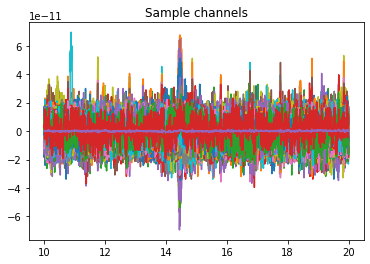

In [3]:
"""
案例：
获取10-20秒内的良好的MEG数据

# 根据type来选择 那些良好的MEG信号(良好的MEG信号，通过设置exclude="bads") channel,
结果为 channels所对应的的索引
"""
picks = mne.pick_types(raw.info, meg=True, exclude='bads')
t_idx = raw.time_as_index([10., 20.])
data, times = raw[picks, t_idx[0]:t_idx[1]]
plt.plot(times, data.T)
plt.title("Sample channels")

plt.show()